# Continuity-preserving simplification of rectangular artifacts

This notebook contains experiments simplifying rectangular artifacts while preserving continuity of the network.

In [33]:
import folium
import geopandas as gpd
import matplotlib.pyplot as plt
import momepy
import numpy as np
import pandas as pd
import shapely
from core import utils
from folium import plugins
from itertools import combinations

from libpysal import graph
from scipy import sparse
from tqdm import tqdm

Specify case metadata

In [4]:
case = "Liège"

Read road data

In [5]:
roads = utils.read_parquet_roads(case)

Remove false nodes (nodes with degree 2)

In [6]:
%%time
roads = momepy.remove_false_nodes(roads)

CPU times: user 34.7 s, sys: 90.7 ms, total: 34.8 s
Wall time: 36.2 s


Measure continuity of street network

In [7]:
%%time
coins = momepy.COINS(roads, angle_threshold=)

CPU times: user 2.41 s, sys: 42.8 ms, total: 2.45 s
Wall time: 2.75 s


Assing continuity group

In [8]:
%%time
roads["coins_group"] = coins.stroke_attribute()

CPU times: user 4.26 s, sys: 20 ms, total: 4.28 s
Wall time: 4.53 s


Assign length of each continuity group and a number of segments within the group.

In [9]:
coins_grouped = roads.length.groupby(roads.coins_group)
roads["coins_len"] = coins_grouped.sum()[roads.coins_group].values
roads["coins_count"] = coins_grouped.size()[roads.coins_group].values

Read artifacts

In [10]:
artifacts = gpd.read_parquet(
    f"../data/{utils.city_fua[case]}/polygons",
    columns=["geometry", "is_artifact", "circular_compactness"],
)
artifacts = artifacts[artifacts.is_artifact].reset_index(drop=True)
artifacts["id"] = artifacts.index

Get nodes from the network.

In [11]:
first = shapely.get_point(roads.geometry, 0)
last = shapely.get_point(roads.geometry, -1)
possible_nodes = gpd.GeoSeries(
    pd.concat([first, last], ignore_index=True), crs=roads.crs
)
nodes = possible_nodes[~possible_nodes.duplicated()]

Link nodes to artifacts

In [12]:
node_idx, artifact_idx = artifacts.sindex.query(
    nodes.buffer(0.1), predicate="intersects"
)
intersects = sparse.coo_array(
    ([True] * len(node_idx), (node_idx, artifact_idx)),
    shape=(len(nodes), len(artifacts)),
    dtype=np.bool_,
)

Filter out rectangles, i.e. artifacts with four entry points.

In [13]:
rectangles = artifacts[intersects.sum(axis=0) == 4]

Apply additional filters to remove artifacts that are not suitable for simplification. These may be artifacts that:
- are too large in size
- have a shape that is too non-rectanglish (*I am sure this is not a word but I like it anyway*)
- are part of a larger intersection that may need different methods of simplification

In [14]:
area_threshold = 1250  # this is hard to determine but it can be done iteratively using different thresholds
circular_compactness_threshold = 0.15  # same as above

rook = graph.Graph.build_contiguity(artifacts, rook=True)

# keep only those artifacts which occur as isolates, i.e. are not part of a larger intersection
rectangles = rectangles.loc[rectangles.index.intersection(rook.isolates)]
rectangles = rectangles.loc[
    (rectangles.area < area_threshold)
    & (rectangles.circular_compactness > circular_compactness_threshold)
]

Figure out which segments are on the ends of their continuity groups.

In [15]:
roads_contiguity = graph.Graph.build_contiguity(roads, rook=False).assign_self_weight()
grouper = roads.coins_group.take(roads_contiguity._adjacency.index.codes[1]).groupby(
    roads_contiguity._adjacency.index.codes[0]
)
coins_end = []
for i, g in grouper:
    coins_end.append((g == g.loc[i]).sum() in (1, 2))
roads["coins_end"] = coins_end

In [16]:
m = roads.explore(
    "coins_len",
    k=20,
    scheme="quantiles",
    tiles="cartodb positron",
    prefer_canvas=True,
    name="Roads",
    highlight_kwds={"color": "red"},
    max_zoom=52,
)
rectangles.explore(m=m, name="Artifacts")
nodes.explore(m=m, name="Nodes", color="red")
folium.LayerControl().add_to(m)
plugins.MousePosition().add_to(m)

m

- roundabout
    - 50.6239 5.60087
    - snap to centroid
- parallels
    - two incoming, one before and after
        - 50.62848 5.59877
        - 50.62929 5.64827
        - replace with a centerline
    - two before and after
        - 50.63506 5.57835
        - replace with a centerline
- rectangle
    - two before and after, one ending, one isolated
        - 50.62784 5.58373
            - keep the two, snap the entry point across to the node
        - 50.59088 5.53892
            - remove the shortcut?
- triangle with additional entry point
    - 50.62095 5.62205
        - ?
    - 50.64175 5.64026
        - ? (what if there's more than one additional?)
    - 50.66548 5.63043
    - 50.71791 5.68404
    - 50.62879 5.54425
- trapezoid
    50.6834 5.64015
- possible remapping of continuity?
    - 50.66448 5.57893

## Case 1

If all four edges are part of the same continuiry block (roundabout):
- drop all of them and link the entry points to the centroid of the artifact

<Axes: >

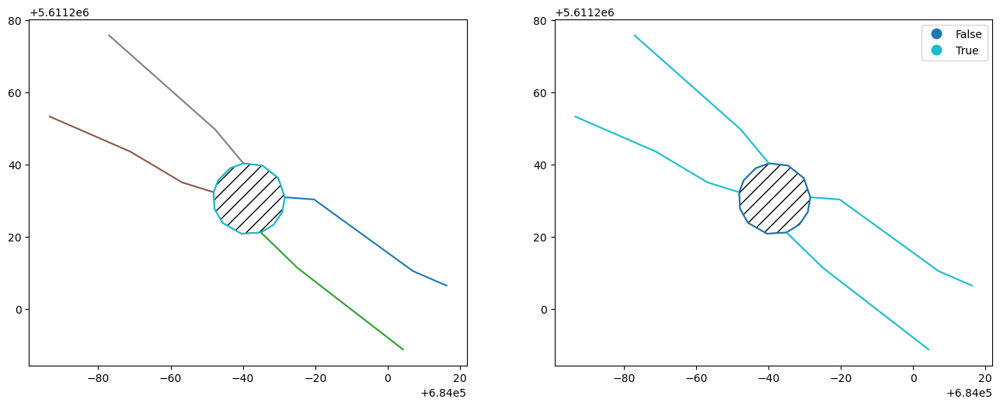

In [17]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.60087, 50.6239)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [18]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 0  # no ends
assert (edges.coins_count == 1).sum() == 0  # no continuity block is a single edge
assert edges.coins_group.nunique() == 1  # all edges belong to the same continuity block

Mark all for removal and replace them with shortest lines to the centroid.

In [19]:
centroid = geom.centroid.item()
relevant_nodes = nodes.iloc[nodes.sindex.query(geom.item(), predicate="intersects")]


to_drop = []
to_add = []

to_drop.extend(edges.index.to_list())
to_add.extend(shapely.shortest_line(relevant_nodes, centroid).to_list())

Generate new road data

In [20]:
new_roads = pd.concat(
    [roads.geometry.drop(to_drop), gpd.GeoSeries(to_add, crs=roads.crs)]
)

Verify

<Axes: >

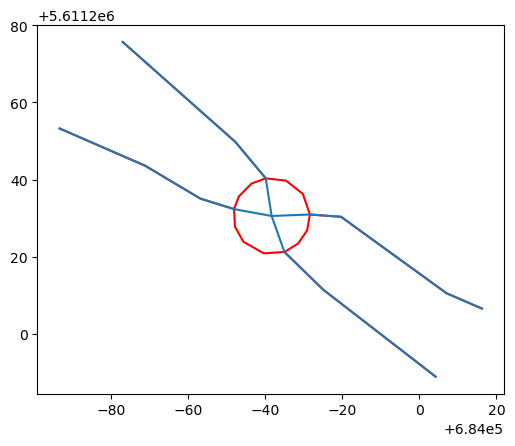

In [21]:
ax = new_roads.clip(geom.buffer(50)).plot(zorder=2)
roads.clip(geom.buffer(50)).plot(ax=ax, color="red", zorder=1)

## Case 2

Two edges are part of an incoming continuity group that ends there, one edge is part of a group that continues before and after.
- replace the incoming with the centerline

<Axes: >

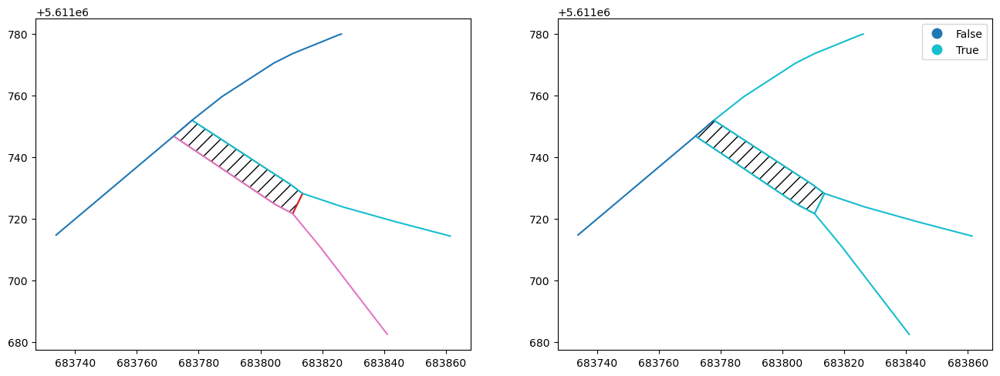

In [22]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.59877, 50.62848)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

<Axes: >

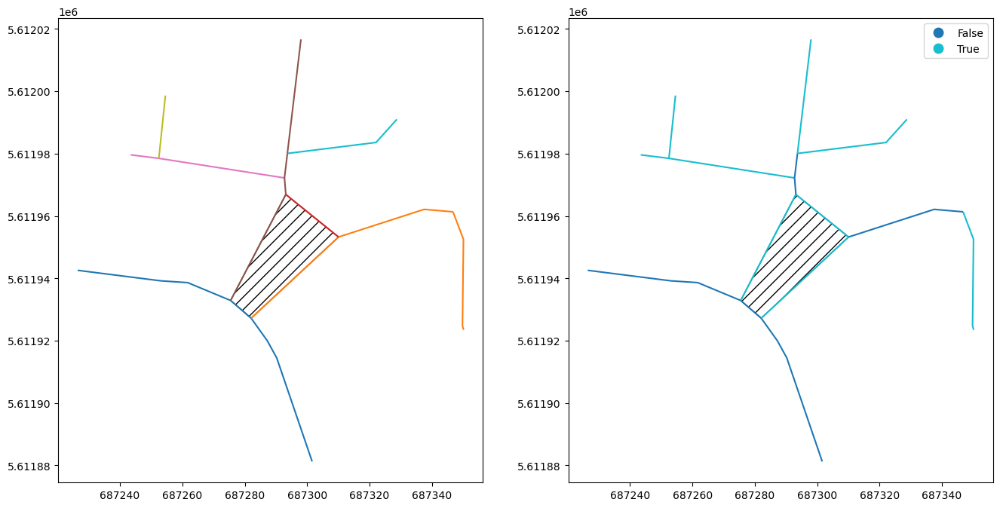

In [23]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.64827, 50.62929)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

Get relevant edges to work with and assert this is indeed the specific case

In [24]:
edges = roads.iloc[roads.sindex.query(geom.item(), predicate="covers")]

assert len(edges) == 4  # ensure rectangle
assert edges.coins_end.sum() == 3  # 3 ends
assert (edges.coins_count == 1).sum() == 1  # 1 continuity block is a single edge

In [25]:
edges_to_merge = edges[edges.coins_end].segmentize(1)
coordinates = edges_to_merge.get_coordinates()

In [26]:
from scipy.spatial import Voronoi

In [27]:
voronoi_diagram = Voronoi(coordinates)
pts = voronoi_diagram.ridge_points

In [29]:
coordinates

,x,y
2593,687310.065355,5.611953e+06
2593,687309.347257,5.611953e+06
2593,687308.629159,5.611952e+06
2593,687307.911061,5.611951e+06
2593,687307.192963,5.611951e+06
...,...,...
3041,687306.993914,5.611956e+06
3041,687307.761774,5.611955e+06
3041,687308.529635,5.611954e+06
3041,687309.297495,5.611954e+06


In [32]:
mapped = coordinates.index.values[pts]

In [52]:
from libpysal.cg import voronoi_frames

<Axes: >

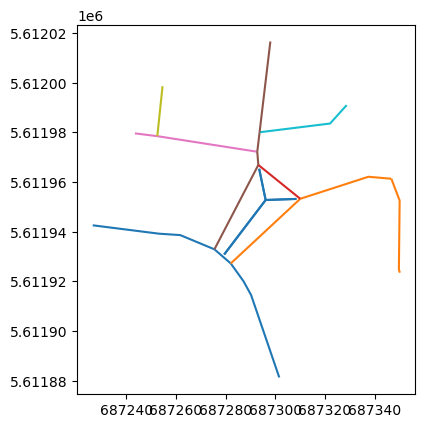

In [60]:
ax = voronoi_frames(edges_to_merge, segment=1, return_input=False, as_gdf=False).boundary.clip(geom.buffer(-1).item()).plot()
roads.clip(geom.buffer(50)).plot("coins_group", ax=ax, categorical=True)

In [74]:
# helper functions
def get_ids(x, ids):
    return ids[x]


mp = np.vectorize(get_ids, excluded=["ids"])


def dist(p1, p2):
    return np.sqrt(((p1[0] - p2[0]) ** 2) + ((p1[1] - p2[1]) ** 2))


def get_verts(x, voronoi_diagram):
    return voronoi_diagram.vertices[x]


def _average_geometry(lines, poly=None, distance=2):
    """
    Returns average geometry.


    Parameters
    ----------
    lines : list
        LineStrings connected at endpoints forming a closed polygon
    poly : shapely.geometry.Polygon
        polygon enclosed by `lines`
    distance : float
        distance for interpolation

    Returns list of averaged geometries
    """
    if not poly:
        poly = shapely.box(*lines.total_bounds)
    # get an additional line around the lines to avoid infinity issues with Voronoi
    extended_lines = list(lines) + [poly.buffer(distance).exterior]

    # interpolate lines to represent them as points for Voronoi
    points = np.empty((0, 2))
    ids = []

    shapely_lines = extended_lines
    lengths = shapely.length(shapely_lines)
    for ix, (line, length) in enumerate(zip(shapely_lines, lengths)):
        pts = shapely.line_interpolate_point(
            line, np.linspace(0.1, length - 0.1, num=int((length - 0.1) // distance))
        )  # .1 offset to keep a gap between two segments
        points = np.append(points, shapely.get_coordinates(pts), axis=0)
        ids += [ix] * len(pts)

        # here we might also want to append original coordinates of each line
        # to get a higher precision on the corners, but it does not seem to be
        # necessary based on my tests.

    # generate Voronoi diagram
    voronoi_diagram = Voronoi(points)

    # get all rigdes and filter only those between the two lines
    pts = voronoi_diagram.ridge_points
    mapped = mp(pts, ids=ids)

    # iterate over segment-pairs
    edgelines = []
    for a, b in combinations(range(len(lines)), 2):
        mask = (
            np.isin(mapped[:, 0], [a, b])
            & np.isin(mapped[:, 1], [a, b])
            & (mapped[:, 0] != mapped[:, 1])
        )
        rigde_vertices = np.array(voronoi_diagram.ridge_vertices)
        verts = rigde_vertices[mask]

        # generate the line in between the lines
        edgeline = shapely.line_merge(
            shapely.multilinestrings(get_verts(verts, voronoi_diagram))
        )
        snapped = shapely.snap(edgeline, shapely_lines[a], distance)
        edgelines.append(snapped)
    return edgelines

<Axes: >

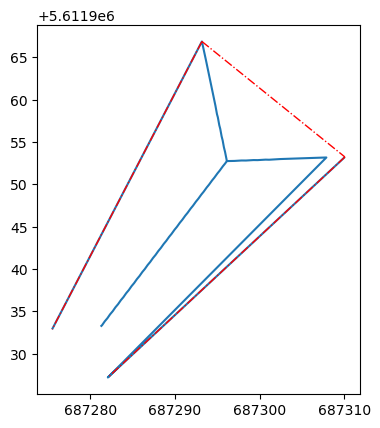

In [91]:
ax = gpd.GeoSeries(_average_geometry(edges_to_merge, geom.item(), distance=1)).plot()
edges_to_merge.plot(ax=ax, color="r", linestyle="-.", linewidth=1)

In [117]:
lines = edges_to_merge
distance = 1
poly = shapely.box(*lines.total_bounds)

extended_lines = list(lines) + [poly.buffer(distance).exterior]

# interpolate lines to represent them as points for Voronoi
points, ids = shapely.get_coordinates(shapely.segmentize(extended_lines, distance), return_index=True)

# generate Voronoi diagram
voronoi_diagram = Voronoi(points)

# get all rigdes and filter only those between the two lines
pts = voronoi_diagram.ridge_points
mapped = ids[pts]
rigde_vertices = np.array(voronoi_diagram.ridge_vertices)

# iterate over segment-pairs
edgelines = []
for a, b in combinations(range(len(lines)), 2):
    mask = (
        np.isin(mapped[:, 0], [a, b])
        & np.isin(mapped[:, 1], [a, b])
        & (mapped[:, 0] != mapped[:, 1])
    )
    verts = rigde_vertices[mask]

    # generate the line in between the lines
    edgeline = shapely.line_merge(
        shapely.multilinestrings(voronoi_diagram.vertices[verts])
    )
    # snapped = shapely.snap(edgeline, extended_lines[a], distance)
    edgelines.append(edgeline)

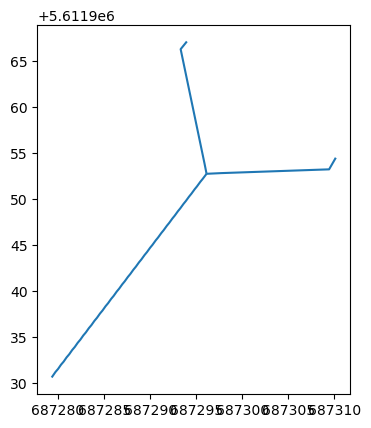

In [118]:
ax = gpd.GeoSeries(edgelines).plot()


## Case 3

two before and after
        

<Axes: >

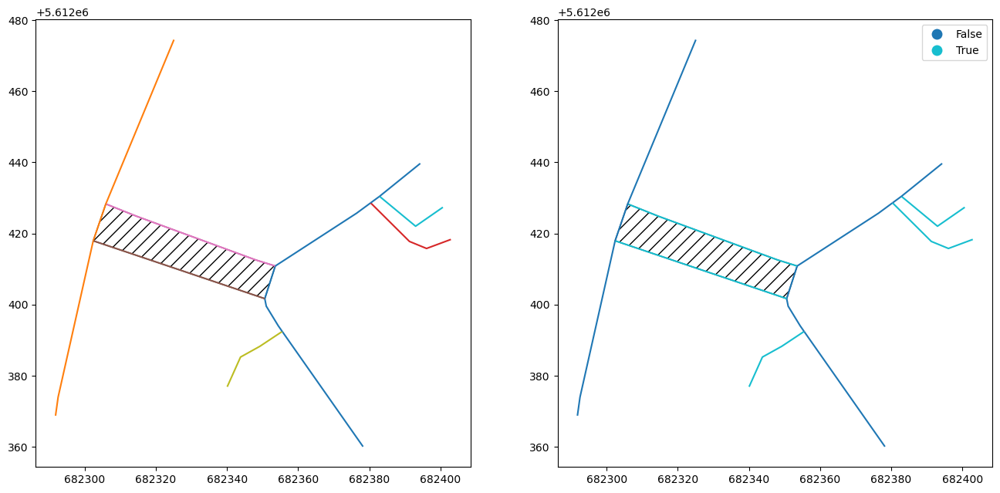

In [ ]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.57835, 50.63506)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

## Case 4

rectangle
    - two before and after, one ending, one isolated        

<Axes: >

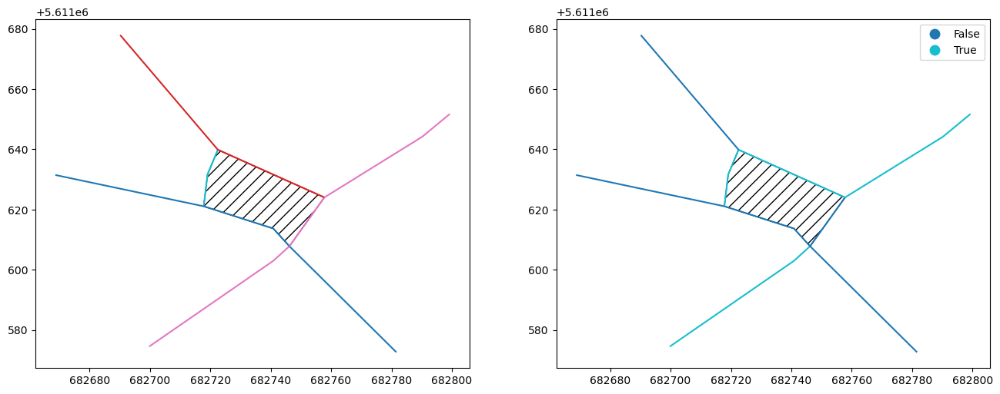

In [124]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.58373, 50.62784)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

## Case 4b

two before and after
        

<Axes: >

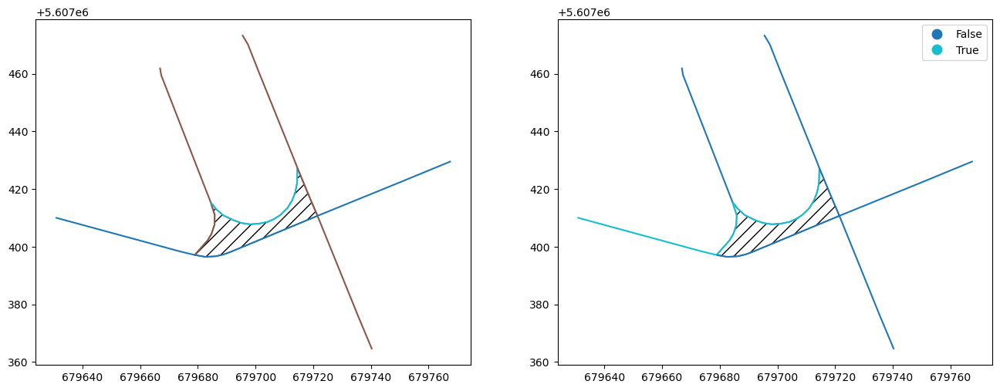

In [125]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.53892, 50.59088)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

## Case 5

triangle with additional entry point        

<Axes: >

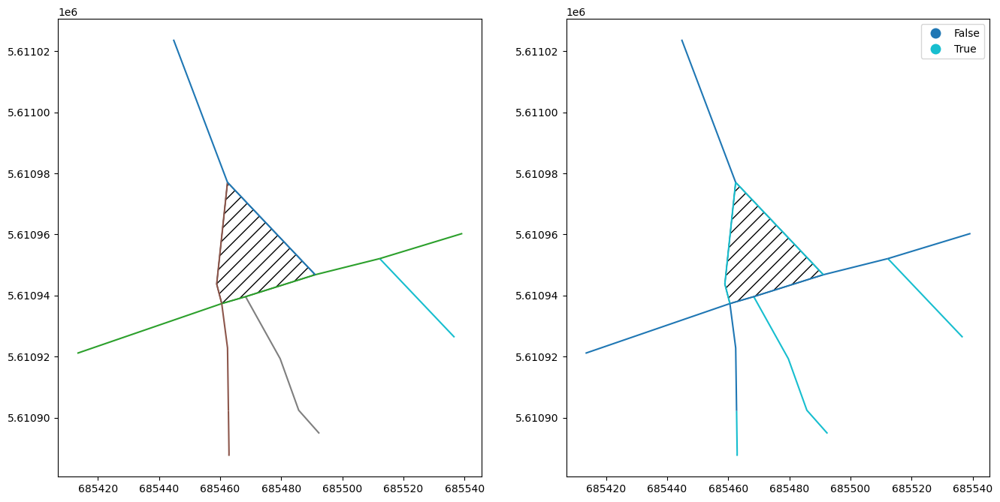

In [126]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.62205, 50.62095)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

<Axes: >

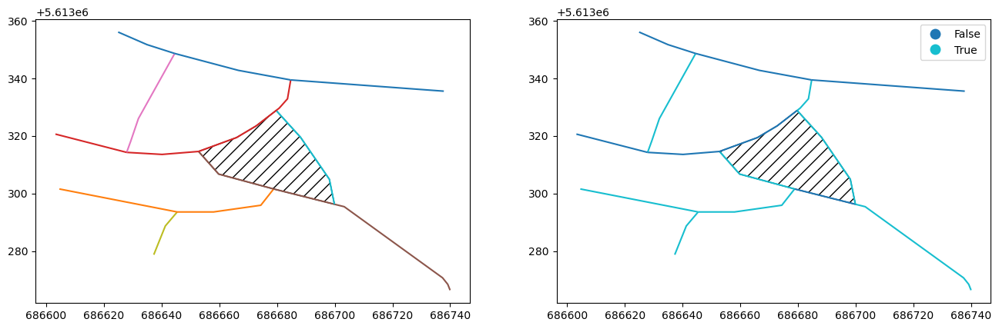

In [127]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.64026, 50.64175)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

<Axes: >

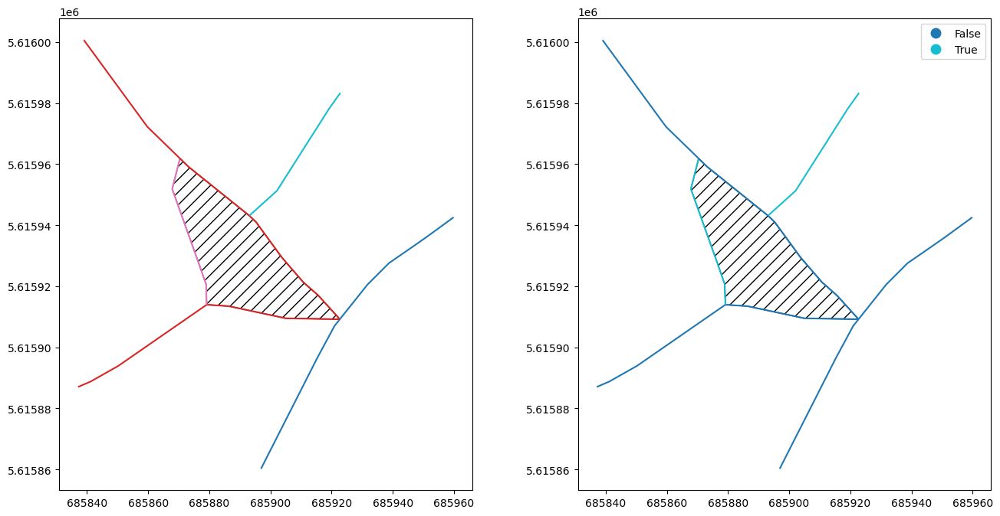

In [129]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.63043, 50.66548)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

<Axes: >

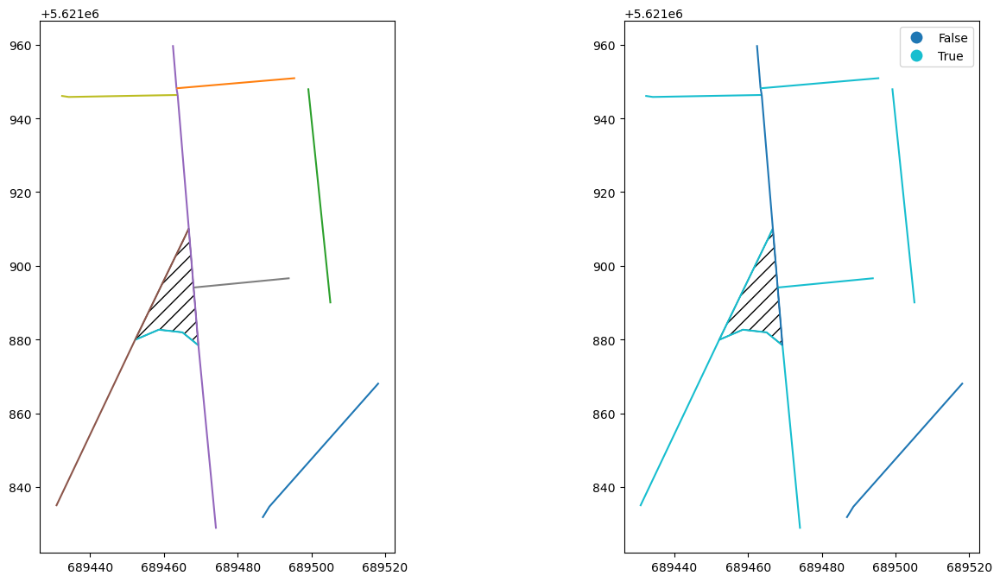

In [130]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.68404, 50.71791)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

<Axes: >

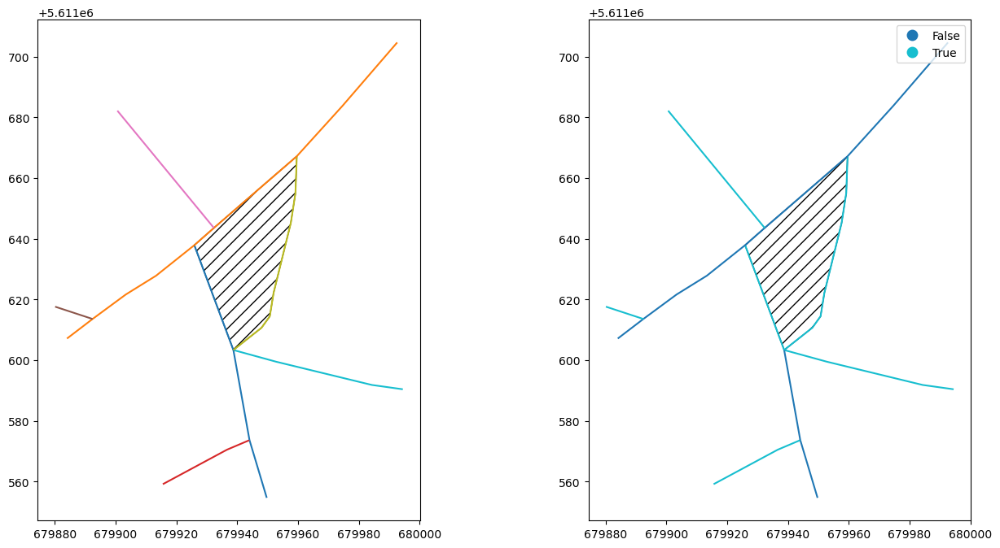

In [131]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.54425, 50.62879)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

## Case 5

trapezoid

<Axes: >

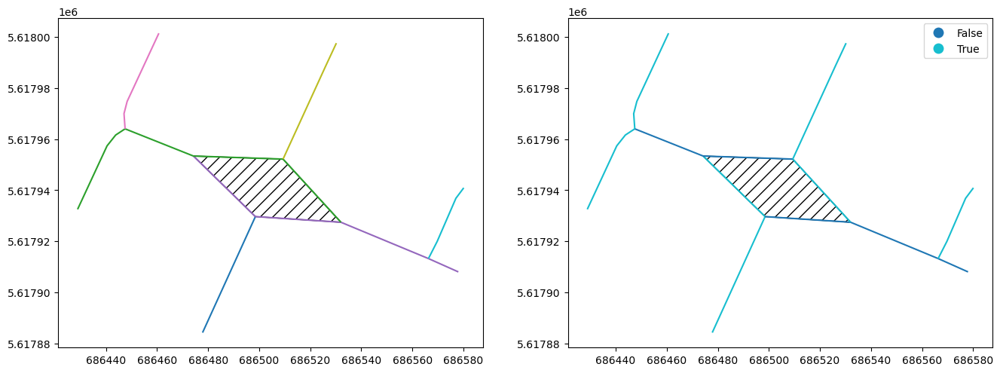

In [132]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.64015, 50.6834)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)

## Case 5

possible remapping of continuity

<Axes: >

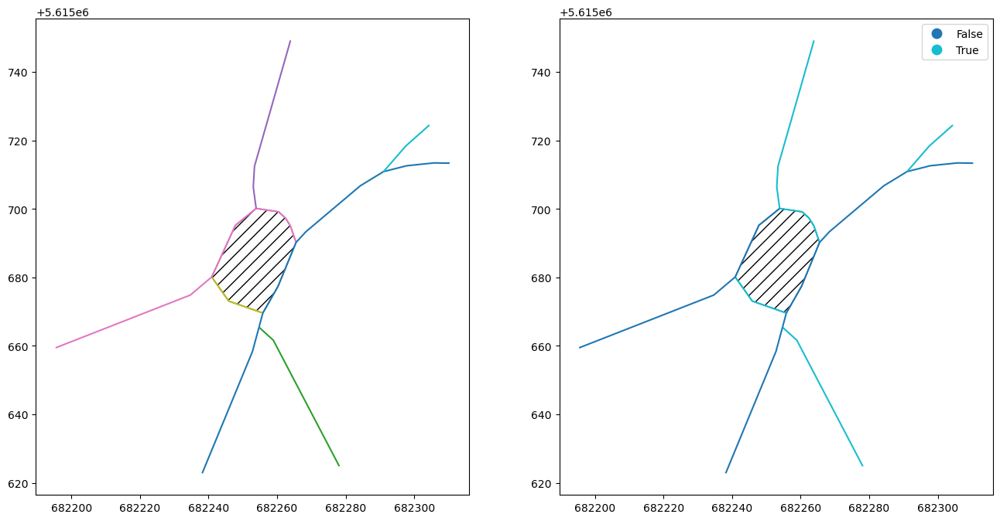

In [133]:
geom = rectangles.geometry[
    rectangles.contains(
        gpd.GeoSeries([shapely.Point(5.57893, 50.66448)], crs=4326)
        .to_crs(roads.crs)
        .item()
    )
]

fig, axs = plt.subplots(1, 2, figsize=(16, 8))

geom.plot(hatch="//", ax=axs[0], color="none")
roads.clip(geom.buffer(50)).plot("coins_group", ax=axs[0], categorical=True)
geom.plot(hatch="//", ax=axs[1], color="none")
roads.clip(geom.buffer(50)).plot("coins_end", ax=axs[1], categorical=True, legend=True)